# Lowrance sonar: data analysis in python 
*Author:* Corrado Motta - corradomotta92@gmail.com

Data that we collect with our Lowrance sonar are stored in a binary file with the extension sl2. Currently we  use reefMaster, a private tool, to show and interpret the data (e.g. depth, coordinates and bouncing data) that are contained in the file.
However, if we are able to decode the binary file and get the data we need, we can process them directly in python, without the need to use reefMaster. Furthermore, we can automatically identify variation in the bouncing data (such as Posidonia Oceanica presence) instead of setting waypoints manually, which would reduce drastically the time needed for the analysis.

This notebook is a first attempt to decode the sl2 file by proceeding step by step and by providing some textual explanation where needed. It does the following:
1. Decode the sl2 file and store the data into variables.
2. Produce a point shapefile containing the track and the depth for each point detected by the sonar.
3. Produce two maps showing the track, the depth and the location with coordinates.
4. Process the bouncing data and produce a plot to show them (similarly to ReefMaster).

Please note that the script is far to be completed but can be very useful for whoever wants to work further on this topic in the future. Future possible steps are:
- Reduce the amount of code (many smarter way to write the script and avoid so many data transformation and for loops) and polish it.
- Look into the bouncing data and check its variation when Posidonia is detected (first step into automatizing the analysis).

This script is very much based on existing resources Tim found on GitHub:

- https://github.com/nwhoffman/sl2PyDecode
- https://github.com/bjcosta/sonar

The second one is a very complete and complex python program to decode sonar data, however it does not work with our sl2 files (out of the box ) and i still did not figure out why.

## Decoding sl2 file
As previously mentioned the sl2 file is in binary format and therefore needs to be decoded.
The PDF linked here makes our life much easier as it contains almost all the info we need to correctly decode the file: 
- https://www.memotech.franken.de/FileFormats/Navico_SLG_Format.pdf

Please read the above document carefully. In short, the sl2 file contains a header of 8 bytes (in the case of sl2 format 2) and is then divided into frames (or blocks). Therefore, for each new point detected by the sonar a new frame is created into the file. Each frame has several fixed fields that are located always at the same offset with a specific type. For example:
- Water depth at offset **64** with type `float`.
- packetSize at offset **34** with type `ushort` (tells us the size of the bouncing data).
- longitude at offset **108** with type `int`.
- latitude at offset **112** with type `int`.

and many other such as temperature, speed etc. A very important field is the **channel** (offset 32, type ushort) as the sonar has different channel types, the main ones are:

| Channel value | Meaning |
| --- | --- | 
| 0 | Primary (Traditional sonar) |
| 1 | Secondary (Traditional sonar) |
| 2 | DSI (Downscan imaging) |
| 5 | Composite (Sidescan) |
| 10 | Debug 1 |
| 11 | Debug 2 |

This fixed section of the frame ends at byte 144 where we finally can find the bouncing data that we are interested in. The bouncing data are of **different size** and therefore we use the `packetSize` field to correctly identify the lenght. Bouncing data are stored simply as `uint8`. After the bouncing data a new frame starts.

What i discover, which makes our life easier is that **each channel seems to have a fixed size for the bouncing data**, for example, in the case of channel 0 (the one we are mostly interested in) the size of bouncing data is always 3072 bytes whilst if channel is 5 the length is 2800.

Let's start by importing the packages needed. The numpy library is used to create n-dimensional arrays that will contain the data needed for each frame.

In [ ]:
# imports
import os
import sys
import math
import numpy as np

In the next code snippet we have the variable that can be configured: `sl2filename` (which will be used also to create the result files),  `path` for the result folder and `channel` we want to decode (default is channel 0). 
We also have some constants that can be configured: `VIEW_DATA_MAX_SIZE` for the chunk of the file we want to decode (default is the whole file), `SONAR_DATA_MAX_SIZE` for the length of the bouncing data for each frame, it depends on the chanel so default is 3072 (which is the length for channel 0 and 1). Finally, `BOUNCING_DATA_MAX_SIZE` is used to define how many frames should be included in the final plot of the bouncing data. Default is 5120 but `sys.maxsize` can be used to view them all. Unfortunately i still have some issues in setting the size of the plot adequately so the entire sl2 file can be too large to show into one single plot.

In [ ]:
# configurable parameters
sl2fileName = 'KATSADIA01' # do not put the sl2 extension and save it in the same location of the notebook.
path = 'Result'
channel = 0

# constants
VIEW_DATA_MAX_SIZE = sys.maxsize  
SONAR_DATA_MAX_SIZE = 3072
BOUNCING_DATA_MAX_SIZE = 5120 # set to sys.maxsize for the whole

We then proceed with the actual decoding

In [3]:
# constants for conversions
rad_polar = 6356752.3142 # polar radius of the Earth
feet2m = 1/3.2808399  # feet to meter conversions
POLAR_EARTH_RADIUS = 6356752.3142;

# open the sl2file
sl2file =  sl2fileName + str('.sl2')
with open(sl2file, "rb") as myfile:
    
    # find the size of the file (in bytes)
    sl2file_size = os.path.getsize(sl2file)
    print('File size (bytes) :', sl2file_size)
    print('Decoding....(may take a few seconds)')
    
    # --------- Dtypes used-----------------
    # Dtype to find the size of each block
    dt_block = np.dtype({'blockSize': ('<u2', 28)})
    
    # Dtype for the rest of the data from each block
    sl2blocks_dtype = np.dtype(dict(
      names=['depth', 'packetSize' , 'channel','upper_limit', 'lower_limit', 'FrameIndex' ,'longitude', 'latitude', 'temperature','speed'],
      offsets=[64, 34, 32, 40, 44, 36, 108, 112, 104, 100], # counted from start of the block in bytes
      formats=["f4", np.ushort ,np.ushort,"f4","f4", np.uint, "<u4", "<u4", "f4", "f4"],
    ))
    
    # Dtype for the bouncing data
    bouncing_data = np.dtype({'bouncing': (np.uint8 , 144)})
    
    # ---------------------------------------
    
    # file header is 10 bytes
    block_offset = 8 
    
    # empty list for block locations
    block_offset_list = [] 
    
    # create a list with all block offsets
    while block_offset < sl2file_size:
        # start at the beginning of each block, Just locating after the header for the first block
        myfile.seek(block_offset,0)
         # read the block size
        block_size = np.fromfile(myfile, dtype=dt_block, count=1)
        #print(block_size)
        # increase the block position marker
        block_offset = block_offset + block_size[0][0] 
        # list of offsets to use later
        block_offset_list.append(block_offset) 

    # position in block_offset_list
    i=0 
    # list to hold the data
    block_data = [] 
    # counter
    data_size = 0
    # iterate over each block
    for i in range(len(block_offset_list)-1):
        # find the beginning of each block
        myfile.seek(block_offset_list[i],0) 
        # get data with the dtype created before
        data_array = np.fromfile(myfile, dtype=sl2blocks_dtype, count=1)
        
        # save retrieved data into single variables
        depth = data_array[0][0]
        psize = data_array[0][1]
        channel = data_array[0][2]
        upperl = data_array[0][3]
        lowerl = data_array[0][4]
        findex = data_array[0][5]
        lon = data_array[0][6]
        lat = data_array[0][7]
        temp = data_array[0][8]
        speed = data_array[0][9]
        
        # now let's reed the bouncing data
        # repositioning
        myfile.seek(block_offset_list[i] + 144 ,0)
        # get data with the bouncing data dtype 
        bdata = np.fromfile(myfile, dtype='uint8', count=psize)
        
        if (channel == 0):       

            # convert depth, lower and Upper limit to meters (negative depth)
            depthM = (depth * feet2m) #*-1
            upperlM = (upperl * feet2m)
            lowerlM = (lowerl * feet2m)
            
            # convert coords to degrees
            longitude =  lon / POLAR_EARTH_RADIUS * (180.0 / math.pi)
            latitude = ((2*math.atan(math.exp(lat/rad_polar)))-(math.pi/2)) * (180/math.pi)

            # fill the block data list with dictionaries
            block = {'waterDepthM': depthM, 'psize': psize ,'frame_index': findex, 'channel' : channel, 'upperlM' : upperlM, 'lowerLM' : lowerlM, 'longitude': longitude, 'latitude': latitude, 'bdata': bdata }
            block_data.append(block)
            # increment the counter
            data_size += 1
            
            # check if the counter has reached the MAX value
        if data_size >= VIEW_DATA_MAX_SIZE:
            print("Max capacity reached")
            break  
    myfile.close() # close the file opened in the while loop
print('Decoding complete. Number of blocks decoded: ', len(block_data))

File size (bytes) : 1144265096
Decoding....(may take a few seconds)
Decoding complete. Number of blocks decoded:  66513


## Shapefile and interactive maps
Now `block_data` contains a list of dictionaries. Each element of the list represents one block which contains all the important information that we need (in the form of python dictionaries). We can now process these data to obtain useful results such as shapefile and maps.

Let's start by importing the packages needed for these operations. Matplotlib and bokeh are used to make the plot, pandas, geopandas and shapely are used respectively for dataframes, shapefiles and geometries.

In [4]:
# imports for matplotlib and pandas_bokeh (backend)
import matplotlib
from matplotlib import pyplot as plt
import pandas_bokeh

# imports for making the shapefiles and the plot
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon

Now we proceed by creating our shapefile.

In [5]:
# create the file where to save our shapefile
shapefile_path = os.path.join(path, 'shapefiles')
if not os.path.exists(shapefile_path):
    os.makedirs(shapefile_path)
shapefile_out_name = sl2fileName + '_trail.shp'
outfp = os.path.join(shapefile_path, shapefile_out_name)

# create an empty gdp database where to store our trail information
sonardata = gpd.GeoDataFrame()

# make lists of data we need from the dictionaries
d_plt = [-d['waterDepthM'] for d in block_data]
lon_plt = [d['longitude'] for d in block_data]
lat_plt = [d['latitude'] for d in block_data]

# save them into a pandas dataframe
df = pd.DataFrame(
    {'depth': d_plt,
     'Latitude': lat_plt,
     'Longitude': lon_plt})

# create the geopandas shapefile with crs included
gdf = gpd.GeoDataFrame(
    df, crs= "EPSG:4326", geometry=gpd.points_from_xy(df.Longitude, df.Latitude))

# write results into the shapefile
gdf.to_file(outfp)
print('The shapefile is stored in: ', str(outfp))

The shapefile is stored in:  Result\shapefiles\KATSADIA01_trail.shp


Next step is to create a map with matplotlib. First of all, to make a better map, i will combine the previously created shapefile with a simple polygon shapefile that contains the Lipsi land. If you want just download one and add the path to this configurable variable:  

In [6]:
# Filepath where our vector map of Lipsi is stored (if you have any land shapefile uncomment this line and set the path)
fp = "Shapefile/lipsi_masked.shp"
# If you are not interested
#fp = None 

The image is stored in:  Result\images\KATSADIA01_trail.png


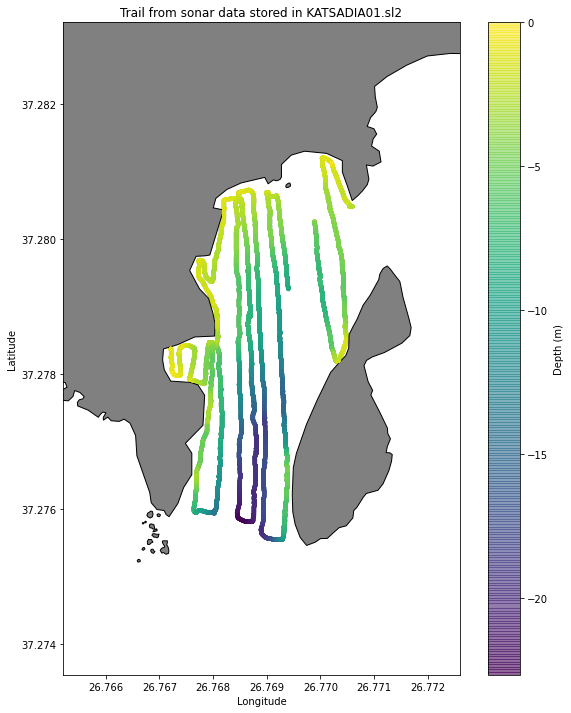

In [7]:
# Create a png file in our results folder where to save our shapefile
shapefile_path = os.path.join(path, 'images')
if not os.path.exists(shapefile_path):
    os.makedirs(shapefile_path)
shapefile_out_name = sl2fileName + '_trail.png'
outimg = os.path.join(shapefile_path, shapefile_out_name)

# find the bounds of the trail
minx, miny, maxx, maxy = gdf.total_bounds

# extend it by little to have a more comphrensive image
minx = minx - 0.002
miny = miny - 0.002
maxx = maxx + 0.002
maxy = maxy + 0.002

# set the size of the image and create the plots
plt.rcParams['figure.figsize'] = [10, 12]
fig, ax = plt.subplots()

# set aspect to equal
ax.set_aspect('equal')

# set the x and y lim as defined before
ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)

# set labels and title
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.title('Trail from sonar data stored in {0}'.format(sl2file))

# set the bar for the depth information
cax = plt.scatter(lon_plt, lat_plt, c=d_plt, 
                  s=10, cmap='viridis', alpha=0.6)

cbar = fig.colorbar(cax)
cbar.set_label('Depth (m)', labelpad=6)

# if the land shapefile is present then we add it on the background
if(fp):
    # Read our landMask shapefile using geopandas
    landMask = gpd.read_file(fp)
    # plot landmask first
    landMask.plot(ax=ax,color='grey', edgecolor='black')

# plot our trail (on top of the landmask)
gdf.plot(ax=ax, column = "depth", marker='o',
         markersize=3)

# save it to a file
fig.savefig(outimg, dpi=100)
print('The image is stored in: ', outimg)

Finally, we can also show the results with Bokeh, a powerful package for interactive plots and images.

In [8]:
# set the output on the notebook
pandas_bokeh.output_notebook()
pd.set_option('plotting.backend', 'pandas_bokeh')

#plot
prova = gdf.plot_bokeh(title='Trail by channel 0',color="red", 
                       category="depth",
                       colormap="Viridis",  figsize=(900, 600),
                       xlabel='Longitude', ylabel='Latitude',
                       xlim=[minx, maxx], ylim=[miny, maxy],
                       )


Loading BokehJS ...

## Plotting the bouncing data
This final section is the most complicate one. Also, i did not have time to really polish the code so the script might be a little bit less commented and a little bit more confusionary. Further, the data that we previously stored in the `block_data` list are now reprocessed and restored in other more complex variables. This step could obviously be avoided by using such complex variables at the beginning but i felt was good to keep this notebook modular so that each section is indipendent and can be easily understood. 

We start as usual by importing the modules needed. Xarray is a very powerful (and indeed complicate) package that comes as an extension of the numpy n-dimensional array. The extra feature here is the possibility to add **labels** to the data. These labels will be later used by the Holoviews package to create our final composite plot to show the bouncing data among predefined coordinates (i.e. the labels).

In [9]:
import warnings
import xarray as xr
import holoviews
import holoviews.operation.datashader

# needed to show the plot in the notebook
from bokeh.plotting import show

We are ready to save our data into xarray dataset.

In [10]:
# defining variables needed (lots of arrays)
data_size = 0
ds_dict = {}
frame_index_arr = []
depth_arr = []
b_data_arr = []
lower_arr = []
upper_arr = []
psize_arr = []

# creating a nparray for adding my bouncing data
bouncing_data = np.zeros((BOUNCING_DATA_MAX_SIZE, SONAR_DATA_MAX_SIZE), dtype='uint8')

# in this for loop i am simply restoring the block_data into arrays that i will use to fill the xarray dataset
for d in block_data:
    
    # data from a single dataframe
    b_data = d['bdata']
    # channel
    channel = d['channel']  
    # frame_index
    frame_index = d['frame_index']
    frame_index_arr.append(frame_index)   
    # depth
    depth = d['waterDepthM']
    depth_arr.append(depth)   
    # upper and lower limits
    lower = d['lowerLM']
    upper = d['upperlM']
    lower_arr.append(lower)
    upper_arr.append(upper) 
    # size
    psize = d['psize']
    b_data_arr.append(psize)  
    #adding bouncing data into the previously created nparray (2d array)
    bouncing_data[data_size][0:len(b_data)] = b_data
    bouncing_data[data_size][len(b_data):] = np.zeros(SONAR_DATA_MAX_SIZE - len(b_data), dtype='uint8')
 
    #checking the size of the data 
    data_size +=1
    if data_size >= BOUNCING_DATA_MAX_SIZE:
        print("Max capacity of {0} reached".format(data_size))
        break
        
# now i have all data stored in the array, as i want to work with xarray i am adding the labels to them (channel and frame index that will be used for the plot and measurement units)
# water_depth
ds_dict['water_depth'] =  (
                    ['channel', 'frame_index'],
                    [depth_arr[0:data_size]],
                     {'units': 'meters'}
                )
# lower limit for normalization
ds_dict['lowerLM'] =  (
                    ['channel', 'frame_index'],
                    [lower_arr[0:data_size]],
                     {'units': 'meters'}
                )
# upper limit for normalization
ds_dict['upperlM'] =  (
                    ['channel', 'frame_index'],
                    [upper_arr[0:data_size]],
                     {'units': 'meters'}
                )
# size of data
ds_dict['data_size'] =  (
                    ['channel', 'frame_index'],
                    [b_data_arr[0:data_size]],
                     {'units': 'meters'}
                )
# bouncing data
ds_dict['data'] = (
            ['channel', 'frame_index', 'depth_bin'], 
            [bouncing_data[0:data_size]], 
            {'units': 'amplitude'}
)
#finally i am able to create my dataset
ds = xr.Dataset(ds_dict, coords={
    'depth_bin': (['depth_bin'], range(0, len(bouncing_data[0]))),
    'frame_index': (['frame_index'], frame_index_arr[0:data_size]),
    'channel': (['channel'], [channel])
})
print('Restoring complete. Number of blocks restored: ', data_size)

Max capacity of 5120 reached
Restoring complete. Number of blocks restored:  5120


Now, before proceeding with the plot we want to normalize our parameters. This steps is required especially by holoviews to be able to correctly show the data on the plot. In the following code snippet, two functions for normalization are defined. These methods are taken from the gitHub project i mentioned above and adjusted to our needs:

In [11]:
# normalization methods
def InterpSingle(unadjusted_depth_amplitudes, unadjusted_depth_amplitudes_size, unadjusted_min, unadjusted_max, frame_index):
    if (frame_index % 1000) == 0:
        total = len(ds.frame_index)
        perc = 100.0 * frame_index / total
    unadjusted_depth_per_bin = (unadjusted_max - unadjusted_min) / bin_count

    min_index = (adjusted_min - unadjusted_min) / unadjusted_depth_per_bin
    max_index = ((adjusted_min + ((bin_count - 1) * adjusted_depth_per_bin)) - unadjusted_min) / unadjusted_depth_per_bin
    index_mapping = np.linspace(min_index, max_index, bin_count)
    adjusted_depth_amplitudes = np.interp(
        index_mapping, 
        range(0, unadjusted_depth_amplitudes_size), 
        unadjusted_depth_amplitudes[0:unadjusted_depth_amplitudes_size], 
        left=0, 
        right=0)
    # We might as well normalize to the full bin range
    assert(len(adjusted_depth_amplitudes) == bin_count)

    return adjusted_depth_amplitudes

def Interp(*args, **kwargs):

    data = args[0]
    data_size = args[1]
    upper_limit = args[2]
    lower_limit = args[3]
    frame_index = args[4]

    adjusted = []
    for i in range(0, len(upper_limit)):
        d = data[i]
        s = data_size[i]
        u = upper_limit[i]
        l = lower_limit[i]
        t = frame_index[i]
        result = InterpSingle(d, s, u, l, t)
        adjusted.append(result)

    return adjusted

Now that the methods are defined we can proceed with the actual normalization. For that we will use our `upper_limit` and `lower_limit` we stored before.

In [12]:
# normalization
# adjusting min and max values
adjusted_min, adjusted_max = ds.upperlM.min().values.item(), ds.lowerLM.max().values.item()
adjusted_min = math.floor(adjusted_min)
adjusted_max = math.ceil(adjusted_max)
bin_count = int(ds.data_size.values.flatten()[0].item())
print('bin_count: %s', bin_count)

# adjusting depth
adjusted_depth_per_bin = (adjusted_max - adjusted_min) / bin_count
print('adjusted_depth_per_bin: %s', adjusted_depth_per_bin)
adjusted_bin_depths = [adjusted_min + (j * adjusted_depth_per_bin) for j in range(0, bin_count)]
print('adjusted_bin_depths[0]: %s ... [-1]: %s', adjusted_bin_depths[0], adjusted_bin_depths[-1])

# creating the variables used as arguments of the two previously defined functions
# our bouncing data xarray
data_arr = ds.data.values[0]
# our size data xarray
data_size_arr = ds.data_size.values.flatten() 
# our upper limit xarray
upper_limit_arr = ds.upperlM.values.flatten()
# our lower limit xarray
lower_limit_arr = ds.lowerLM.values.flatten() 
# our frame index xarray
frame_index_arr = ds.frame_index.values.flatten()

# we can now call the function
normalized = xr.apply_ufunc(
    Interp, 
    data_arr, 
    data_size_arr,
    upper_limit_arr, 
    lower_limit_arr, 
    frame_index_arr, 
    input_core_dims=[['depth_bin'], [], [], [], []], 
    output_core_dims=[['depth']],
)

# we are now finally able to create our xarray dataset!
x = xr.Dataset({'amplitudes': (['frame_index', 'depth'], normalized, {'units': 'amplitude'})}, coords={'frame_index': (['frame_index'], frame_index_arr), 'depth': (['depth'], adjusted_bin_depths)})
print("Normalization process completed.")

bin_count: %s 3072
adjusted_depth_per_bin: %s 0.005208333333333333
adjusted_bin_depths[0]: %s ... [-1]: %s 0.0 15.994791666666666
Normalization process completed.


Finally by making use of the holoviews library we can plot our complex bouncing data in a way that reminds all in all ReefMaster.

**Note:** For some reason i still could not set the size of the plot in the way i wished. So the plot is quite small.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
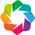

The image is stored in:  Result\images\KATSADIA01_bouncing_data.png


In [13]:
# Ignore a warning given by the bokeh and holoviews versions
warnings.filterwarnings("ignore")

# Create a png file in our results folder where to save our shapefile
bouncing_path = os.path.join(path, 'images')
if not os.path.exists(bouncing_path):
    os.makedirs(bouncing_path)
shapefile_out_name = sl2fileName + '_bouncing_data.png'
outbounce = os.path.join(bouncing_path, shapefile_out_name)

# setting some needed extension to use bokeh on the notebook
holoviews.extension('matplotlib')
holoviews.extension('bokeh')
renderer = holoviews.renderer('bokeh').instance(mode='server')

# loading the dataset
hv_ds = holoviews.Dataset(x)
img = hv_ds.to(holoviews.Image, kdims=["frame_index", "depth"])
img = img.opts(cmap='viridis', logz=False)
img = img.opts(tools=['hover', 'crosshair'])

# setting up the table and the curves (i.e. the water depth)
depth_data = holoviews.Table((ds.frame_index.values.flatten(), ds.water_depth.values.flatten()), 'frame_index', 'depth')
depth_curve = holoviews.Curve(depth_data)
depth_curve = depth_curve.opts(line_width=0.5, color='red', alpha=0.5) #, line_dash='dashed')
depth_curve = depth_curve.opts(tools=['hover', 'crosshair'])
depth_curve = depth_curve.opts(active_tools=['box_zoom'])

# setting the size of the plot (TODO: do not work)
x_size = 1024
y_size = 768 

# rasterize the image
rasterized_img = holoviews.operation.datashader.rasterize(img, width=x_size, height=y_size, precompute=True)
rasterized_img = rasterized_img.opts(invert_yaxis=True)

# combine all layers
graph = holoviews.Overlay([rasterized_img, depth_curve])
graph = graph.collate()

# shows in the notebook and save into file
show(holoviews.render(graph,  backend='bokeh'))
holoviews.save(graph, outbounce)
print('The image is stored in: ', outbounce)